# Rapport TP mixte UP2 : Apprentissage statistique

## Najlaa Srifi_______ Hajar EL Fahfouhi_________Léa Bagheri 

## 1.Analyse statiqtique

On visualise d'abord notre base de données qui contient 351 observations et 33 variables dont la variable "class" est celle qu'on cherche à expliquer

In [1]:
#%% importation des données
import pandas as pd
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
dataframe=pd.read_csv('Ionosphere.csv',sep=';')
dataframe.head(5)

,a01,a02,a03,a04,a05,a06,a07,a08,a09,a10,...,a24,a25,a26,a27,a28,a29,a30,a31,a32,class
0,0.99539,-0.05889,0.85243,0.02306,0.83398,-0.37708,1.00000,0.03760,0.85243,-0.17755,...,-0.51171,0.41078,-0.46168,0.21266,-0.34090,0.42267,-0.54487,0.18641,-0.45300,g
1,1.00000,-0.18829,0.93035,-0.36156,-0.10868,-0.93597,1.00000,-0.04549,0.50874,-0.67743,...,-0.26569,-0.20468,-0.18401,-0.19040,-0.11593,-0.16626,-0.06288,-0.13738,-0.02447,b
2,1.00000,-0.03365,1.00000,0.00485,1.00000,-0.12062,0.88965,0.01198,0.73082,0.05346,...,-0.40220,0.58984,-0.22145,0.43100,-0.17365,0.60436,-0.24180,0.56045,-0.38238,g
3,1.00000,-0.45161,1.00000,1.00000,0.71216,-1.00000,0.00000,0.00000,0.00000,0.00000,...,0.90695,0.51613,1.00000,1.00000,-0.20099,0.25682,1.00000,-0.32382,1.00000,b
4,1.00000,-0.02401,0.94140,0.06531,0.92106,-0.23255,0.77152,-0.16399,0.52798,-0.20275,...,-0.65158,0.13290,-0.53206,0.02431,-0.62197,-0.05707,-0.59573,-0.04608,-0.65697,g


Puisqu'on est face à un problème de classification, On doit déterminer combien de classes contient notre base de données.

In [ ]:
np.unique(dataframe['class'])

array(['b', 'g'], dtype=object)

Pour faire l'analyse statistique, on travaille seulement avec les variables quantitatives qui sont au nombre de 32

In [2]:
#%%var quantitatives
dataquant=dataframe.drop(dataframe.columns[-1],axis=1)
dataquant.head(5)

,a01,a02,a03,a04,a05,a06,a07,a08,a09,a10,...,a23,a24,a25,a26,a27,a28,a29,a30,a31,a32
0,0.99539,-0.05889,0.85243,0.02306,0.83398,-0.37708,1.00000,0.03760,0.85243,-0.17755,...,0.56811,-0.51171,0.41078,-0.46168,0.21266,-0.34090,0.42267,-0.54487,0.18641,-0.45300
1,1.00000,-0.18829,0.93035,-0.36156,-0.10868,-0.93597,1.00000,-0.04549,0.50874,-0.67743,...,-0.20332,-0.26569,-0.20468,-0.18401,-0.19040,-0.11593,-0.16626,-0.06288,-0.13738,-0.02447
2,1.00000,-0.03365,1.00000,0.00485,1.00000,-0.12062,0.88965,0.01198,0.73082,0.05346,...,0.57528,-0.40220,0.58984,-0.22145,0.43100,-0.17365,0.60436,-0.24180,0.56045,-0.38238
3,1.00000,-0.45161,1.00000,1.00000,0.71216,-1.00000,0.00000,0.00000,0.00000,0.00000,...,1.00000,0.90695,0.51613,1.00000,1.00000,-0.20099,0.25682,1.00000,-0.32382,1.00000
4,1.00000,-0.02401,0.94140,0.06531,0.92106,-0.23255,0.77152,-0.16399,0.52798,-0.20275,...,0.03286,-0.65158,0.13290,-0.53206,0.02431,-0.62197,-0.05707,-0.59573,-0.04608,-0.65697


Avant de calculer les indicateurs, On propose de tracer la distribution des différents variables par paires en utilisant la fonction pairplot(), dans le but de visualiser les liens entre eux. Les deux couleurs "blue, oranges" font référence au deux classe de notre base de données "g, b"

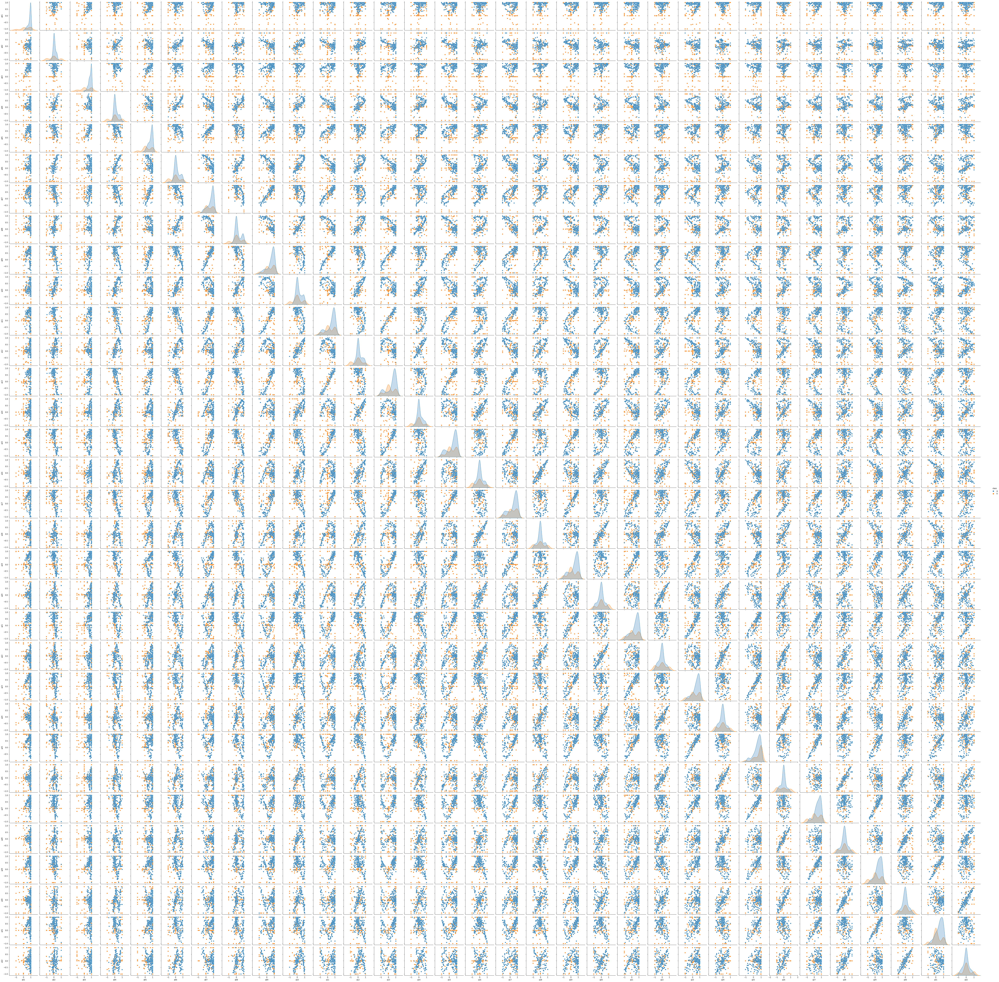

In [ ]:
import seaborn as sns
sns.pairplot(dataframe, hue='class')

### Moyenne: 

Text(0, 0.5, 'Moyenne de la variable')

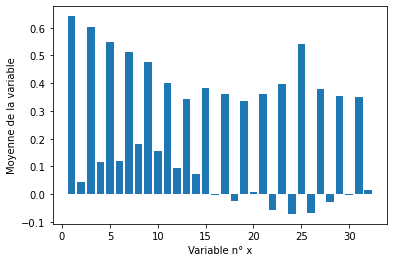

In [3]:
#%%moyennes 
import numpy as np
data_matrix=dataquant.iloc[:,:].values
moy=[]
for i in range(data_matrix.shape[1]):
    moy+=[np.mean(data_matrix[:,i])]
    
import matplotlib.pyplot as plt
plt.bar(np.linspace(1,32,32),moy) #32 = data_matrix.shape[1]
plt.xlabel('Variable n° x')
plt.ylabel('Moyenne de la variable')

Les moyennes sont hétérogènes de telle façon qu'il existe des moyennes négatives et d'autres sont positives 

### Variance 

Text(0, 0.5, 'Variance de la variable')

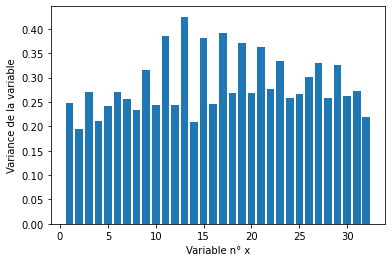

In [ ]:
#%%var
var=[]
for i in range(data_matrix.shape[1]):
    var+=[np.var(data_matrix[:,i])]
    
plt.bar(np.linspace(1,32,32),var)
plt.xlabel('Variable n° x')
plt.ylabel('Variance de la variable')

Les variances sont plutôt homogènes (même ordre de grandeur). On calcule aussi la variance globale :

In [ ]:
#%%var globale
np.var(data_matrix)

0.33403342115599405

### Ecart-type: 

Text(0, 0.5, 'Ecart-type')

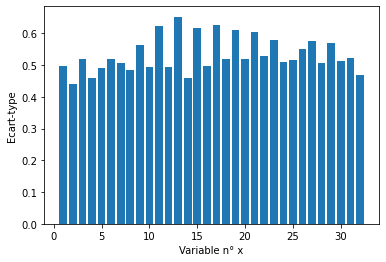

In [ ]:
Ecart=dataquant.std()
plt.bar(np.linspace(1,32,32),Ecart)
plt.xlabel('Variable n° x')
plt.ylabel('Ecart-type')

Les écart-types sont aussi homogènes et ont en générale le même ordre de dispersion

### Covariance: 

<AxesSubplot:>

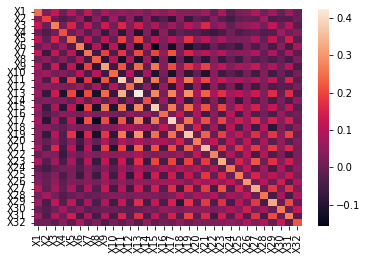

In [ ]:
import seaborn as sns
data_transpose= np.transpose(pd.DataFrame.to_numpy(dataquant))
covaraince_data = np.cov(data_transpose, bias=True)
sns.heatmap(covaraince_data, xticklabels=['X'+ np.str(i) for i in range(1,33)],yticklabels=['X'+ np.str(i) for i in range(1,33)])

On remarque l'exsitence des variables qui évoluent  dans le même sens (la covariance est de signe positif) alors que d'autres  évoluent dans le sens contraire (la covariance est négative)

### Synthèse: boxplot 

<AxesSubplot:>

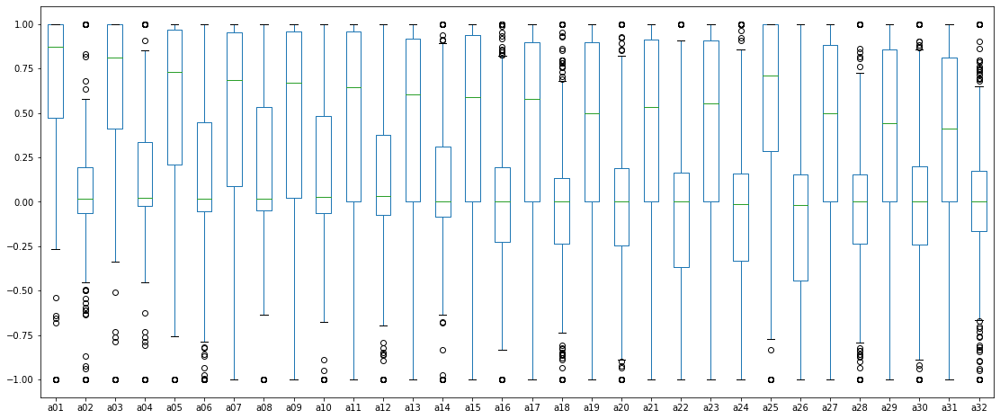

In [ ]:
#on utilise le boxplot de pandas plutôt que celui de pyplot car le pyplot ne permet pas de choisir la taille de la figure
dataquant.boxplot(grid=False,figsize=(19,8))

D'après ce graphique on remarque qu'il existe plusieurs variables qui ont la même moyenne comme les variables a30 et a20 et a16, du coup, on peut dire que ces variables sont corrélées et peuvent être regroupé a une seule variable, c'est l'esprit de l'ACP. Les petits cercles qu'on observe montrent la présence des anomalies ou des points aberrants que notre objectif sera de les déterminer dans la suite du TP


### Histogramme: 

<AxesSubplot:ylabel='Frequency'>

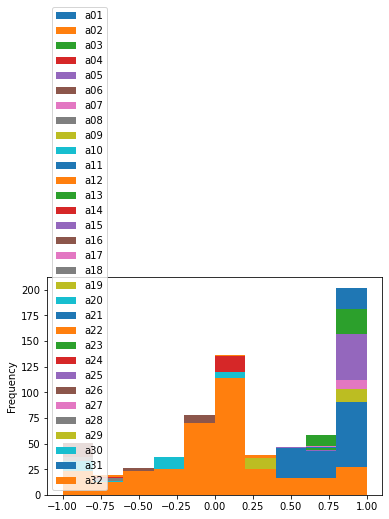

In [ ]:
dataquant.plot.hist()

## 2. Forêt Aléatoire

Dans cette partie on commence d'abord par transposer la dernière colonne (variable qualitative) en une variable quantitative. On va remplacer 'g' par 1 et 'b' par 0. Ensuite, on divise notre base en données d'apprentissage et en données test tout en le paramètre d'initialisation rd.seed(1234) qui est notamment équivalent au paramètre set.seed(1234). Cette division va nous servir dans toute la suite du TP

In [4]:
#%% label encoding
from sklearn.preprocessing import LabelEncoder
marry_encoder = LabelEncoder()
catCol=['class']
for col in catCol:
    marry_encoder.fit(dataframe[col])
    marry_values = marry_encoder.transform(dataframe[col])
    dataframe[col]=marry_values

dataframe.head(5)

,a01,a02,a03,a04,a05,a06,a07,a08,a09,a10,...,a24,a25,a26,a27,a28,a29,a30,a31,a32,class
0,0.99539,-0.05889,0.85243,0.02306,0.83398,-0.37708,1.00000,0.03760,0.85243,-0.17755,...,-0.51171,0.41078,-0.46168,0.21266,-0.34090,0.42267,-0.54487,0.18641,-0.45300,1
1,1.00000,-0.18829,0.93035,-0.36156,-0.10868,-0.93597,1.00000,-0.04549,0.50874,-0.67743,...,-0.26569,-0.20468,-0.18401,-0.19040,-0.11593,-0.16626,-0.06288,-0.13738,-0.02447,0
2,1.00000,-0.03365,1.00000,0.00485,1.00000,-0.12062,0.88965,0.01198,0.73082,0.05346,...,-0.40220,0.58984,-0.22145,0.43100,-0.17365,0.60436,-0.24180,0.56045,-0.38238,1
3,1.00000,-0.45161,1.00000,1.00000,0.71216,-1.00000,0.00000,0.00000,0.00000,0.00000,...,0.90695,0.51613,1.00000,1.00000,-0.20099,0.25682,1.00000,-0.32382,1.00000,0
4,1.00000,-0.02401,0.94140,0.06531,0.92106,-0.23255,0.77152,-0.16399,0.52798,-0.20275,...,-0.65158,0.13290,-0.53206,0.02431,-0.62197,-0.05707,-0.59573,-0.04608,-0.65697,1


In [5]:
import random as rd
import numpy as np
rd.seed(1234)

data=dataframe.iloc[:,:].values #dataframe as matrix
obs=data.shape[0] #nb d'observations

obs_train=rd.sample(range(obs),int(0.7*obs)) #70% de nb d'observations : observations train
data_train=np.array([data[i,:] for i in obs_train])

data_test=np.array([data[i,:] for i in range(obs) if i not in obs_train]) #le reste des observations : observations test

##test pour vérifier qu'il n'y a pas de superposition
for i in range(data_train.shape[0]):
    for j in range(data_test.shape[0]):
        if False not in (data_train[i,:]==data_test[j,:]):
            print(i,j)

45 74


On remarque qu'il y a une superposition entre data_train et data_test, cette superposition vient bien évidemmnet du fait que dans notre base initiale il exsite une ligne qui se répète, on utilise du coup la fonction duplicated pour déterminer cette ligne

In [6]:
dataframe[dataframe.duplicated(keep=False)]

,a01,a02,a03,a04,a05,a06,a07,a08,a09,a10,...,a24,a25,a26,a27,a28,a29,a30,a31,a32,class
102,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,0
248,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,-1.0,0.0,0.0,0.0,0.0,0.0,0.0,0


une observation présente en double dans les données initiales (lignes 102 et 248 de data / lignes 104 et 250 de l'excel). On va enlever cette observation de data_test (car l'enlever de data_test plutôt que data_train nous rapproche de la répartition 70/30).

In [7]:
np.delete(data_test,74,axis=0)

array([[ 1.0000e+00, -1.8829e-01,  9.3035e-01, ..., -1.3738e-01,
        -2.4470e-02,  0.0000e+00],
       [ 1.0000e+00, -2.4010e-02,  9.4140e-01, ..., -4.6080e-02,
        -6.5697e-01,  1.0000e+00],
       [ 2.3370e-02, -5.9200e-03, -9.9240e-02, ..., -3.9000e-04,
         1.2011e-01,  0.0000e+00],
       ...,
       [ 8.3508e-01,  8.2980e-02,  7.3739e-01, ...,  9.0546e-01,
        -4.3070e-02,  1.0000e+00],
       [ 9.4701e-01, -3.4000e-04,  9.3207e-01, ...,  9.2697e-01,
        -5.7700e-03,  1.0000e+00],
       [ 9.0608e-01, -1.6570e-02,  9.8122e-01, ...,  8.7403e-01,
        -1.6243e-01,  1.0000e+00]])

In [8]:
columns=dataframe.columns
data_train_df=pd.DataFrame(data_train,columns=columns)
data_test_df=pd.DataFrame(data_test,columns=columns)

In [9]:
X_train=data_train_df.loc[:, data_train_df.columns != 'class']
X_test=data_test_df.loc[:, data_test_df.columns != 'class']
y_train=data_train_df['class']
y_test=data_test_df['class']

In [ ]:
X=pd.concat([X_train,X_test],axis=0)
y=pd.concat([y_train,y_test],axis=0)

On implemente notre forêt aléatoire  toute en prenant les valeurs par défaut des paramètres comme première implementation.

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
clf = RandomForestClassifier(random_state=47)
clf.fit(X_train, y_train)
print(clf.score(X_test, y_test))

0.9150943396226415


On obtient une accuracy de 0.91, cette  accuracy déjà bonne mais on va essayer de l'améliorer de plus en optimisant les paramètres

###  Optimisation à la main

Dans un premier temps on va choisir le paramètre de profondeur maximale et le critère soit Gini ou Entropy pour faire l'optimisation à la main

In [ ]:
# finding best depth 

depthGini = {}
depthEn={}
for i in range(1,100):
    clfG = RandomForestClassifier(max_depth=i,random_state=47)
    clfE= RandomForestClassifier(criterion='entropy',max_depth=i,random_state=47)
    clfG.fit(X_train, y_train)
    clfE.fit(X_train, y_train)
    depthGini[i]= clfG.score(X_test, y_test)
    depthEn[i]=clfE.score(X_test, y_test)
#print(depthGini)
#print(depthEn)

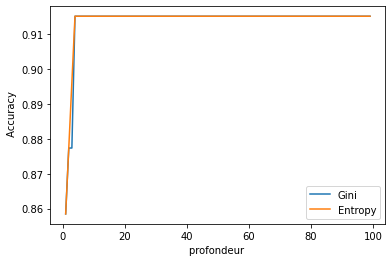

In [ ]:
# plot 
import matplotlib.pylab as plt
lists = sorted(depthGini.items()) 
x, y = zip(*lists)
plt.plot(x, y,label ='Gini')
lists = sorted(depthEn.items()) 
x, y = zip(*lists)
plt.plot(x, y,label ='Entropy')
plt.xlabel('profondeur ')
plt.ylabel(' Accuracy')
plt.legend()
plt.show()

On remarque'il n'y a pas vraiment une grande difference entre le gini et entropy dans le calcule d'impurté pour notre forêt ce qui import est la profondeur.

In [ ]:
print(max(depthGini.values()))
print(max(depthEn.values()))

0.9150943396226415
0.9150943396226415


In [ ]:
def find_key(d,v): 
    for k, val in d.items(): 
        if v == val: 
            return k 
    return "Clé n'existe pas"

print(find_key(depthGini,max(depthGini.values())))  
print(find_key(depthEn,max(depthEn.values())))

4
4


A partir de la profondeur 4 les deux models ont une accuracy maximale de O.91

### Grid From Scratch

L'optimisation à la main n'est pas vraiment crédible au sens qu'on varie que le paramètre profondeur et criterion sans prendre en compte les autres paramètres. Pour cette raison, on cherche à varier tous paramètres de l'algorithme et les optimiser selon l'accuracy . Cela peut être fait avec des boucles qui donne à la fin le meilleur paramètre pour notre modèle et data

In [ ]:
s=0
best_s=0
bootstrap=[True,False] 
for depth in range (20,200):
  print(depth)
  for ne in range(20,1002,100):
    for mf in range(1,20):
      for msl in  range(1,20):
            clf = RandomForestClassifier(
            max_depth=depth,
            max_features=mf,
            min_samples_leaf=msl,
            n_estimators=ne,random_state=47)
            clf.fit(X_train, y_train)
            s=clf.score(X_test, y_test)
            if s> best_s:
              best_s=s
              best_clf=clf
              best_para={
              'max_depth': depth,
              'max_features': mf,
              'min_samples_leaf': msl,
              'n_estimators': ne}
              print(best_s)
              print(best_para)

In [ ]:
best_s

0.9339622641509434

In [ ]:
best_para

{'max_depth': 20,
 'max_features': 10,
 'min_samples_leaf': 2,
 'n_estimators': 320}

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
best_clf = RandomForestClassifier(
 max_depth=20,
 max_features=10,
 min_samples_leaf=2,
 n_estimators=320,random_state=47)
best_clf.fit(X_train, y_train)
print(best_clf.score(X_test, y_test))

0.9339622641509434


Cette recherche a fait la différence. L'accuracy est augmenté de 0.91 à 0.93

### Grid Search with Cross Validation 

In [ ]:
from sklearn.model_selection import GridSearchCV
# on choisie les paramétres en se basant sur les paramétres précédents
param_grid = {
    'bootstrap': [True,False],
    'max_depth': [30,40,50,60],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [200, 300,1000]
}
# Create a based model
rf = RandomForestClassifier()
# Instantiate the grid search model
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 5, n_jobs = -1, verbose = 2)

In [ ]:
# Fit the grid search to the data
grid_search.fit(X_train, y_train)

Fitting 5 folds for each of 432 candidates, totalling 2160 fits


GridSearchCV(cv=5, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'bootstrap': [True, False],
                         'max_depth': [30, 40, 50, 60], 'max_features': [2, 3],
                         'min_samples_leaf': [3, 4, 5],
                         'min_samples_split': [8, 10, 12],
                         'n_estimators': [200, 300, 1000]},
             verbose=2)

In [ ]:
grid_search.best_params_

{'bootstrap': False,
 'max_depth': 50,
 'max_features': 2,
 'min_samples_leaf': 4,
 'min_samples_split': 10,
 'n_estimators': 300}

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
clf = RandomForestClassifier(
  bootstrap=False,
 max_depth=50,
 max_features=2,
 min_samples_leaf=4,
 min_samples_split=10,
 n_estimators=300,random_state=47)
clf.fit(X_train, y_train)
grid_accuracy=clf.score(X_test, y_test)
print(grid_accuracy)

0.9056603773584906


###  Best Model

In [ ]:
clfG = RandomForestClassifier(max_depth=4,random_state=47)
clfE= RandomForestClassifier(criterion='entropy',max_depth=4,random_state=47)
clfG.fit(X_train, y_train)
clfE.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=4, random_state=47)

In [ ]:
print("Best model en recherche a la main Gini",clfG.score(X_test, y_test))
print("Best model en recherche a la main Entropy",clfE.score(X_test, y_test))
print("Best model Grid a la main",best_s)
print("Best model en GridSearch ",grid_accuracy)

Best model en recherche a la main Gini 0.9150943396226415
Best model en recherche a la main Entropy 0.9150943396226415
Best model Grid a la main 0.9339622641509434
Best model en GridSearch  0.9056603773584906


on prend le meilleur modèle qui a le meilleur score en test c'est le modèle obtenu à l'aide de grid search  from scratch

In [ ]:
best_model=best_clf

In [ ]:
# matrice de confusion
from sklearn.metrics import accuracy_score, confusion_matrix
labels=['g','b']
ypred = best_clf.predict(X_test)
pd.DataFrame(confusion_matrix(y_test, ypred), index = labels, columns=labels)

,g,b
g,34,3
b,4,65


## 3.Forêt d'isolement 

On Utilise la même répartition de train et test que celle de la partie précedente.


On commence d'abord par imlementer un forêt d'isolement avec les paramètre dèjà définie par défaut

In [10]:
from sklearn.ensemble import IsolationForest
Model= IsolationForest(n_estimators=100, max_samples='auto',contamination='auto',random_state=47,bootstrap=False,n_jobs=None)
Model.fit(X_train,y_train)
Outliers=Model.predict(X_test)==-1
nb_anomalie=np.count_nonzero(Outliers)
print(nb_anomalie)

39


In [11]:
import plotly.express as px
fig = px.box(data_train_df, y="class")
fig.show()

  Puisque la forêt d'isolement est un modèle d'apprentissage non supervisé, On a pensé à visualiser notre nuage de points afin de voir si les anomalies sont loin des points normaux ou pas, chose qui va nous permettre de valider notre modèle ou non. Du coup, on trace la boîte à moustache de la variable "class" afin de saisir bien notre situation. Vous pouvez remarque que la p-box est anormal par ce que tout simplement on fait l'étude d'un varible catégoriel. 

In [12]:
#Plotting outliers
# adding the anomalies to the dataset 
isolation_model = IsolationForest(n_estimators=100, max_samples='auto',contamination='auto',random_state=47,bootstrap=False,n_jobs=None)
# training the model 
isolation_model.fit(X_train)
IF_predictions = isolation_model.predict(X_test)
XII_test=X_test.copy()
XII_test['anomalies'] = IF_predictions
XII_test['class']=dataframe['class']
anomalies = XII_test.query('anomalies == -1')
# importing the plot
import plotly.graph_objects as go

# plotting the graph for outliers
normal = go.Scatter(x=XII_test.index.astype(str),y=y_test,name="Dataset",mode='markers')
outlier = go.Scatter(x=anomalies.index.astype(str),y=anomalies['class'],name="Anomalies",mode='markers',
                marker=dict(color='red', size=6,
                            line=dict(color='red', width=1)))
# labeling the graph
layout = go.Layout(title="Isolation Forest",yaxis_title='class',xaxis_title='x-axis',)
# plotting 
data=[normal, outlier]
fig=go.Figure(data=data, layout=layout)
fig.show()

Ce graphique ne nous permet pas de valider ou de rejetter notre modèle.

### Gridsearch 

Afin d'optimiser la perfomance, on implemente une gridsearch afin de trouver les paramètres optimaux 

In [ ]:
from sklearn import model_selection
from sklearn.model_selection import GridSearchCV
model = IsolationForest(random_state=47)
param_grid = {'n_estimators': np.arange(10,1000,10), 
              'max_samples': ['auto',len(X_train)], 
              'contamination': ['auto', np.arange(1,245)/245]  
              }

grid_search = model_selection.GridSearchCV(model, 
                                           param_grid,
                                           scoring="neg_mean_squared_error", 
                                           refit=True,
                                           cv=10, 
                                           return_train_score=True)
grid_search.fit(X_train, y_train)
best_model = grid_search.fit(X_train, y_train)
print('Optimum parameters', best_model.best_params_)

Optimum parameters {'contamination': 'auto', 'max_samples': 'auto', 'n_estimators': 40}


In [ ]:
from sklearn.ensemble import IsolationForest
clf=IsolationForest(n_estimators=40, max_samples='auto',contamination='auto',random_state=47,bootstrap=False,n_jobs=None) 
clf.fit(X_train,y_train)
pred = clf.predict(X_test) 
X_test['anomaly']=pred 
outliers=X_test.loc[X_test['anomaly']==-1] 
outlier_index=list(outliers.index) 
print(X_test['anomaly'].value_counts())

 1    68
-1    38
Name: anomaly, dtype: int64


La visualisation en 2D nous ne permettons pas vraiment de valider notre modèle pour cette raison on a pensé à appliquer une ACP afin de réduire le nombre de variables et pouvoir visualier notre base de donnée en 3D 

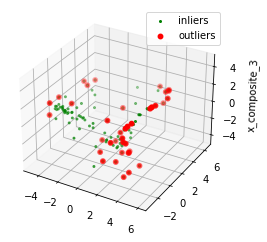

In [ ]:
from sklearn.decomposition import PCA 
from sklearn.preprocessing import StandardScaler 
from mpl_toolkits.mplot3d import Axes3D 
pca = PCA(n_components=3) # Réduire à k=3 dimensions 
scaler = StandardScaler() 
#normaliser les métriques 
X = scaler.fit_transform(X_test) 
X_reduce = pca.fit_transform(X)
fig = plt.figure() 
ax = fig.add_subplot(111, projection='3d') 
ax.set_zlabel("x_composite_3")
# Tracer les points de données compressés 
ax.scatter(X_reduce[:, 0], X_reduce[:, 1], zs=X_reduce[:, 2], s=4, lw=1, label="inliers",c='green')
# Tracer x pour les valeurs aberrantes de la vérité terrain 
ax.scatter(X_reduce[outlier_index,0],X_reduce[outlier_index,1], X_reduce[outlier_index,2], 
           lw=2, s=60, marker=".", c='red', label="outliers") 
ax.legend() 
plt.show()

On remarque que même en 3 D, on ne peut pas vérifier si les anomalies sont éloignées du groupe des points normaux. Ceci est justifié par le fait que notre nuage est déjà distribué selon deux classes qu'on peut facilement visualiser dans le graphique et du coup les points aberrants de chaque classe seront éloignés juste des points normaux de la même classe

In [13]:
from sklearn.ensemble import IsolationForest
Model= IsolationForest(n_estimators=40, max_samples='auto',contamination='auto',random_state=47,bootstrap=False,n_jobs=None)
data_islF=data_train_df.copy()
Model.fit(data_islF)
data_islF['anomaly']=Model.predict(data_islF)
A=pd.DataFrame(data_islF)
reqd_Index = A[A['anomaly']==-1]
anno=pd.DataFrame(A[A['anomaly']==-1])
data_islF.drop(anno.index, inplace=True)

la data "data_islF" correspond à notre base de données après suppression des anomalies

In [14]:
import plotly.express as px
fig = px.box(data_islF, y="class")
fig.show()

On visualise la boîte à moustache après suppression des anomalies et on remarque bien que les points aberrants ont été supprimé comparant au cas initial. Cependant, malgré toutes les plotes qu'on a tracés, aucun plot nous n'a vraiment premet de valider ou de rejetter notre modèle pour cette raison on va essayer de calculer la différence de variance entre notre base de données initiale et la base de données après supression des anomalies. Pour ce faire, on choisit le test ANOVA qui mesure l’indépendance entre une variable qualitative et une quantitative, la variable qualitative dans notre cas est la variable "class". Cette méthode est valable pour tout algorithme d'apprentissage non suppervisé, tant qu'il exsite pas des experts qui peuvent nous valider le modèle. 

### Test Anova 

On va d'abord tester l'indépendance par la varaible quantitative "a13" puisqu'il a la plus grande variance selon l'étude faite dans la première partie du TP.

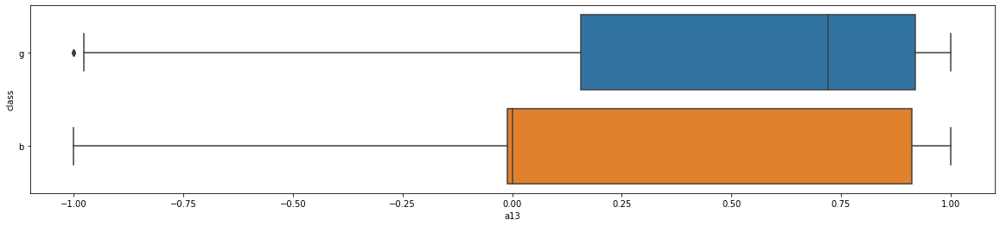

In [ ]:
plt.subplots(figsize=(20,4))
ax = sns.boxplot(x="a13", y="class", data=dataframe)

On s'interesse à la variance de chaque groupe et on effectue le test de bartlett qui permet d'approuver bien évidemment si les variances sont significativement différentes ou non

In [ ]:
dataframe.groupby("class")['a13'].agg('var')

class
b    0.413126
g    0.406785
Name: a13, dtype: float64

In [ ]:
from scipy.stats import bartlett
bartlett(dataframe.a13[dataframe['class'] == 'b'],dataframe.a13[dataframe['class'] == 'g'])

BartlettResult(statistic=0.009581343054651796, pvalue=0.9220241390395033)

la p-value est supérieure à 5%, du coup on accepte l'hypothèse H0 qui stipule que les variances de chaque groupe sont égales.

In [ ]:
import pingouin as pg
aov = pg.anova(dv='a13', between='class', data=dataframe,detailed=True)
aov.round(3)

,Source,SS,DF,MS,F,p-unc,np2
0,class,6.404,1,6.404,15.655,0.0,0.043
1,Within,142.760,349,0.409,NaN,NaN,NaN


In [ ]:
aov = pg.anova(dv='a13', between='class', data=data_islF,detailed=True)
aov.round(3)

,Source,SS,DF,MS,F,p-unc,np2
0,class,3.445,1,3.445,12.91,0.0,0.068
1,Within,47.228,177,0.267,NaN,NaN,NaN


En effectuant le test d'anova sur les deux base de donnée, on remarque que la variance de la base de donnée initiale est plus grande de celle de la data après suppression des anomalies. En conclut l'exsitence d'une différence très significative chose qui nous permet de valider notre modèle d'isolation forest. Pour approuver bien notre résultat, on compare entre la distributon de a variance des deux bases de données. 

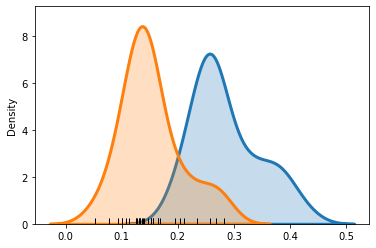

In [ ]:
data_islF.drop('class',1, inplace=True)
data_islF.drop('anomaly',1, inplace=True)
data_matrix1=data_islF.iloc[:,:].values
var1=[]
for i in range(data_matrix1.shape[1]):
    var1+=[np.var(data_matrix1[:,i])]
sns.distplot(var, hist = False, kde = True,
kde_kws = {'shade': True, 'linewidth': 3}, 
label = 'dataframe')  
sns.distplot(var1, hist = False, kde = True,rug=True,
kde_kws = {'shade': True, 'linewidth': 3}, 
label = 'data_islF',rug_kws={'color': 'black'} ) 
plt.show()

La variance à bien écraser à gauche après suppression des points aberrantes.Notre modèle est alors pertinant et a réussit à supprimer les points aberrantes de notre base de données.

###  Le tableau des cinq observations avec les plus bas scores d’anomalies

In [ ]:
X2_test=X_test.copy()
X2_test['score']=clf.decision_function(X_test)
test1=X2_test.sort_values(by='score',ascending=True)
test1.head()

,a01,a02,a03,a04,a05,a06,a07,a08,a09,a10,...,a24,a25,a26,a27,a28,a29,a30,a31,a32,score
65,1.0,-1.00000,-1.0,1.0,-1.0,1.00000,1.0,1.00000,1.00000,1.0000,...,0.00000,1.0,-1.0,1.0,-1.00000,-1.0,1.0000,-1.0,1.00000,-0.152415
10,-1.0,-1.00000,1.0,1.0,1.0,-0.14375,0.0,0.00000,-1.00000,1.0000,...,-1.00000,1.0,-1.0,-1.0,-1.00000,1.0,1.0000,0.0,0.00000,-0.136359
11,-1.0,1.00000,1.0,-1.0,-1.0,1.00000,0.0,0.00000,1.00000,1.0000,...,-1.00000,1.0,1.0,1.0,1.00000,0.0,0.0000,-1.0,-1.00000,-0.135615
47,0.0,0.00000,-1.0,-1.0,-1.0,1.00000,0.0,0.00000,-1.00000,1.0000,...,0.43750,1.0,-1.0,0.0,0.00000,-1.0,-1.0000,-1.0,1.00000,-0.132752
61,1.0,-0.09524,-1.0,-1.0,-1.0,-1.00000,1.0,0.31746,0.81349,0.7619,...,0.36508,1.0,1.0,1.0,0.50794,-1.0,-0.3254,-1.0,0.72831,-0.130787


On remarque que les points aberrantes ont tous approximativement le même score d'anomalie

###  Le tableau des cinq observations avec les plus haut scores d’anomalies

In [ ]:
test1=X2_test.sort_values(by='score',ascending=False)
test1.head()

,a01,a02,a03,a04,a05,a06,a07,a08,a09,a10,...,a24,a25,a26,a27,a28,a29,a30,a31,a32,score
104,0.94701,-0.00034,0.93207,-0.03227,0.95177,-0.03431,0.95584,0.02446,0.94124,0.01766,...,0.03193,0.92489,0.02542,0.92120,0.02242,0.92459,0.00442,0.92697,-0.00577,0.141176
100,0.87578,0.03727,0.89951,0.00343,0.89210,0.00510,0.86335,0.00000,0.95031,0.07453,...,-0.04348,0.82111,0.02033,0.81988,0.08696,0.80757,0.02308,0.80088,0.02441,0.139786
99,0.88110,0.00000,0.94817,-0.02744,0.93598,-0.01220,0.90244,0.01829,0.90244,0.01829,...,0.04878,0.89666,0.02226,0.90854,0.00915,1.00000,0.05488,0.97561,-0.01220,0.138382
80,1.00000,0.08013,0.96775,-0.00482,0.96683,-0.00722,0.87980,-0.03923,1.00000,0.01419,...,0.02003,0.93772,-0.03034,1.00000,-0.05843,0.92774,-0.03464,0.92226,-0.03673,0.136985
105,0.90608,-0.01657,0.98122,-0.01989,0.95691,-0.03646,0.85746,0.00110,0.89724,-0.03315,...,-0.02099,0.89147,-0.07760,0.82983,-0.17238,0.96022,-0.03757,0.87403,-0.16243,0.134355


## 4.ACP 

On va commencer par ne pas standardiser les données car elles sont toutes de même ordre (entre -1 et 1) avec des variances comparables. On n'a pas d'effet d'échelle à contrer.

On remet les fonctions de l'ACP (fonctions du TP ACP)

In [ ]:
#fonctions du TP ACP
import numpy as np
import pandas as pd

#centrage et normalisation des données
def data_centre(data, normalize=False):
    data_centre = data.copy()
    n=data.shape[0]
    for col in data.columns:
        data_centre[col] = (data_centre[col] - (sum(data[col])/n))/(np.std(data[col], ddof=0)*normalize + 1*(1-normalize))
    return data_centre

#valeurs propres et vecteurs propres
def data_Hyperplan(data,k):
    data_transpose = np.transpose(pd.DataFrame.to_numpy(data))
    covariance_data = np.cov(data_transpose, bias=True)
    valeur_propre, vecteur_propre = np.linalg.eig(covariance_data)
    idx =  valeur_propre.argsort()[::-1]   
    valeur_propre1=  valeur_propre[idx]
    vecteur_propre1 = vecteur_propre[:,idx]

    return valeur_propre1[:k], vecteur_propre1[:,:k]

#nouvelles coordonnées dans la base des vecteurs propres
def newcoord(data, normalize=False):
    Vect=data_Hyperplan(data,data.shape[1])[1]
    data=data_centre(data,normalize)
    return np.dot(data,Vect.T)

#qualité de la projection
def Qualite_matrix(M):
    Qualite_matrix = np.dot(np.multiply(M, M), np.triu(np.ones((M.shape[1],M.shape[1]))))  
    Qualite_matrix = np.multiply(Qualite_matrix, np.divide(1.0, Qualite_matrix[:,-1:]))   
    return Qualite_matrix

In [ ]:
#ACP sur toutes les variables
dataf_train=pd.DataFrame(data_train) #matrix as dataframe
data_centre(X_train)
data_Hyperplan(X_train,X_train.shape[1])
M=newcoord(X_train)
Q=Qualite_matrix(M)
pd.DataFrame(Q).head(5) #on le transforme en dataframe juste pour la visualisation
#print(Q[:,-1])

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,0.001322,0.031148,0.052541,0.134178,0.149742,0.214771,0.248718,0.254510,0.292648,0.328970,...,0.863175,0.863355,0.889497,0.906595,0.917237,0.918050,0.921839,0.944762,0.950725,1.0
1,0.182247,0.225694,0.232494,0.238651,0.245715,0.262889,0.263725,0.266165,0.285860,0.293648,...,0.823641,0.853604,0.863596,0.935117,0.955469,0.964639,0.969935,0.995047,0.997012,1.0
2,0.011310,0.017261,0.017263,0.026630,0.026783,0.084323,0.191829,0.216762,0.234767,0.302607,...,0.599317,0.618279,0.643544,0.643656,0.701167,0.701314,0.706272,0.822137,0.970220,1.0
3,0.041826,0.062685,0.095191,0.195507,0.196425,0.221622,0.236606,0.236976,0.242721,0.274770,...,0.909977,0.919560,0.929019,0.929388,0.929435,0.935739,0.949591,0.949681,0.981870,1.0
4,0.017271,0.043938,0.044111,0.045155,0.109403,0.121649,0.207876,0.211600,0.215070,0.350248,...,0.864096,0.885620,0.886655,0.894115,0.927846,0.937651,0.942221,0.958497,1.000000,1.0


### On va choisir une dimension de réduction optimale en se basant sur l'inertie expliquée et la validation croisée

In [ ]:
#calcul de l'inertie expliquée
valp=data_Hyperplan(X_train,X_train.shape[1])[0] #liste des valeurs propres
TI=1/(np.sum(valp))*valp #TI pour chaque composante
print(TI)

[0.31108596 0.12862744 0.07032129 0.06589809 0.05282455 0.03920509
 0.02962102 0.02804503 0.02753987 0.02535834 0.02150077 0.02062005
 0.01884883 0.01824829 0.01465888 0.0136916  0.01309021 0.01248323
 0.01110679 0.01024351 0.00951171 0.00849659 0.00809768 0.00652558
 0.00635137 0.00542823 0.00491672 0.00465663 0.00409075 0.00343043
 0.00298779 0.00248769]


In [ ]:
# TI cumulé

TItot=[]
for i in range(len(TI)):
    TItot+=[np.sum(TI[:i+1])]
pd.DataFrame(TItot)


,0
0,0.311086
1,0.439713
2,0.510035
3,0.575933
4,0.628757
5,0.667962
6,0.697583
7,0.725628
8,0.753168
9,0.778527


Text(0.5, 1.0, 'la variance cumulée')

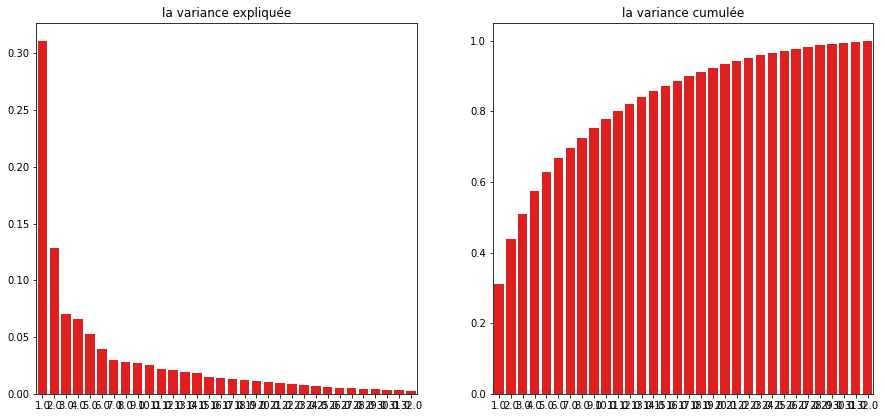

In [ ]:
fig = plt.figure(figsize= (15, 15))
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
sns.barplot(np.linspace(start=1, stop=32, num=32),
            valp.real/(sum(valp.real)),
            color = 'red', 
            ax=ax1).set_title('la variance expliquée')
sns.barplot(np.linspace(start=1, stop=32, num=32),
            np.cumsum(valp.real/(sum(valp.real))),
            color = 'red', 
            ax=ax2).set_title('la variance cumulée')

A priori, k=10 est une bonne dimension pour la réduction : 80% de l'inertie est expliquée, et l'inertie expliquée augmente de moins en moins significativement plus on a de variables

On va vérifier par validation croisée :

In [ ]:
#crossval
from sklearn.model_selection import train_test_split
#division bdd en x et y
X=dataframe.iloc[:,:-1].values
Y=dataframe.iloc[:,-1].values
#initialisation
n_run = 10
valp=np.zeros((n_run,dataframe.shape[1])) #10 lignes 33 colonnes
TI=valp

for i in range(n_run) :
    X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.3)
    d_train=np.zeros((X_train.shape[0],dataframe.shape[1])) #combinaison X_train et Y_train
    d_train[:,:-1]=X_train
    d_train[:,-1]=Y_train
    d_train=pd.DataFrame(d_train)
    valp[i,:]=data_Hyperplan(d_train,d_train.shape[1])[0] #liste des valeurs propres
    TI[i,:]=1/(np.sum(valp[i,:]))*valp[i,:] #TI pour chaque composante
    
# TI cumulé
TItot=np.zeros((n_run,dataframe.shape[1]))
for i in range(n_run):
    for j in range(TItot.shape[1]):
        TItot[i,j]=np.sum(TI[i,:j+1])
pd.DataFrame(TItot[:,3:23]) #on coupe le début et la fin pour tout visualiser car on sait que k >= 3 et k<= 23

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,0.597402,0.646985,0.684325,0.715730,0.743440,0.769912,0.792801,0.813063,0.832399,0.850480,0.866724,0.881493,0.895021,0.907671,0.918075,0.928158,0.937713,0.945297,0.952701,0.959145
1,0.590814,0.641355,0.680422,0.713594,0.743135,0.768994,0.791407,0.811338,0.829426,0.845082,0.860571,0.875578,0.890012,0.903163,0.915316,0.925858,0.934839,0.943049,0.950968,0.958087
2,0.583885,0.634979,0.672214,0.705982,0.736668,0.765353,0.789249,0.810199,0.829392,0.847987,0.864418,0.878754,0.891491,0.903784,0.915658,0.926493,0.937192,0.945358,0.952593,0.959578
3,0.554569,0.608300,0.652529,0.684534,0.715365,0.744215,0.769645,0.792883,0.813237,0.831696,0.847935,0.862518,0.876520,0.889869,0.902057,0.913737,0.924602,0.934137,0.942590,0.951019
4,0.560825,0.612339,0.652570,0.686874,0.716131,0.740576,0.764033,0.786517,0.807656,0.827352,0.845202,0.860856,0.875900,0.889109,0.901391,0.913003,0.923389,0.933137,0.942248,0.950927
5,0.577718,0.629546,0.672646,0.705211,0.737285,0.762715,0.785111,0.806297,0.825758,0.842381,0.858544,0.873414,0.887404,0.899872,0.911691,0.923018,0.933397,0.942701,0.951223,0.958623
6,0.588295,0.641426,0.675962,0.706013,0.735095,0.759978,0.783988,0.806144,0.825008,0.842124,0.858523,0.873530,0.887361,0.900343,0.912585,0.923164,0.932167,0.941077,0.949475,0.957427
7,0.582033,0.633281,0.673226,0.704315,0.735312,0.762828,0.785330,0.806525,0.825934,0.844762,0.860958,0.876123,0.890236,0.902203,0.913549,0.924061,0.934045,0.942635,0.950679,0.957770
8,0.580781,0.633690,0.677706,0.707587,0.736909,0.763672,0.786570,0.808286,0.826294,0.842324,0.857127,0.871527,0.885115,0.898489,0.910739,0.921798,0.931056,0.939952,0.948067,0.955359
9,0.589641,0.635903,0.676244,0.710728,0.741372,0.770010,0.792957,0.814887,0.833856,0.851997,0.868079,0.882259,0.895523,0.907744,0.918622,0.928444,0.937692,0.945443,0.953059,0.959826


Les 10 runs produisent des résultats équivalents : on confirme k=10

On va visualiser nos points en dimension k=3.

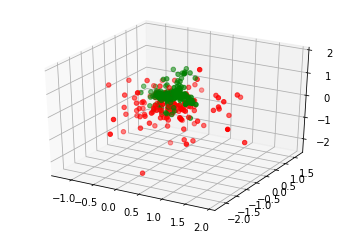

In [ ]:
#visualisation
import matplotlib.pyplot as plt
#nouvelles coord
N=newcoord(dataframe)
N=N[:,:3].T #on garde les 3 premières var et on transpose pour le plot
color=[] #vecteur des couleurs
for i in range(dataframe.shape[0]):
    if dataframe.iloc[i,-1]:
        color+=['green'] #si class='g'=1 : on plot en vert
    else:
        
        color+=['red'] #sinon on plot en rouge
        
#on garde les 3 premiers axes pour visualiser
ax=plt.axes(projection='3d')
ax.scatter3D(N[0,:],N[1,:],N[2,:],color=color)
plt.show()

On voit des clusters de points verts et rouges, bien que la séparation ne soit pas claire en dimension 3

### Qualité de la projection 

In [ ]:
#on reprend les mêmes individus test que précédemment
#calcul de la qualité de la projection sur k=10 composantes
M=newcoord(X_test)
Q=Qualite_matrix(M)[:,:10] #on garde les 10 premières composantes

In [ ]:
#récupération des 5 individus les moins bien projetés
m=[] #les 5 minima
q=Q[:,-1].tolist()
#print(q)
for i in range(5):
    m+=[min(q)]
    q.remove(min(q))
print(m)

ind=[] #indices des 5 points dans data_test/Q
for j in m:
    ind+=[Q[:,-1].tolist().index(j)]
print(ind)

[0.12022786348562921, 0.13944344182565765, 0.15202605053672483, 0.1570706445724313, 0.17924615352981857]
[28, 20, 1, 3, 97]


In [ ]:
#caractéristiques statistiques : comparer à la moyenne et variance
out=np.array([data_test[28,:],
             data_test[20,:],
             data_test[1,:],
             data_test[3,:],
             data_test[97,:]]) #les 5 points trouvés
pd.DataFrame(out)

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
0,1.00000,-0.14754,1.00000,0.04918,0.57377,-0.01639,0.65574,0.01639,0.85246,-0.03279,...,-0.34426,0.52385,-0.20325,0.32787,-0.03279,0.27869,-0.44262,0.49180,-0.06557,0.0
1,0.84557,-0.08580,-0.31745,-0.80553,-0.08961,-0.56435,0.80648,0.04576,0.89514,-0.00763,...,-0.03718,0.70882,-0.25288,0.77884,-0.14109,-0.21354,-0.78170,-0.18494,-0.59867,0.0
2,1.00000,-0.02401,0.94140,0.06531,0.92106,-0.23255,0.77152,-0.16399,0.52798,-0.20275,...,-0.65158,0.13290,-0.53206,0.02431,-0.62197,-0.05707,-0.59573,-0.04608,-0.65697,1.0
3,0.97588,-0.10602,0.94601,-0.20800,0.92806,-0.28350,0.85996,-0.27342,0.79766,-0.47929,...,-0.81634,0.13659,-0.82510,0.04606,-0.82395,-0.04262,-0.81318,-0.13832,-0.80975,1.0
4,1.00000,1.00000,0.36700,0.06158,0.12993,0.92713,-0.27586,0.93596,-0.31527,0.37685,...,-0.45950,0.85471,-0.06831,1.00000,1.00000,0.38670,0.00246,0.17758,0.79790,1.0


La valeur du point 97 pour la variable 1 est un outlier
La valeur du point 20 pour la variable 3 est un outlier
La valeur du point 20 pour la variable 13 est un outlier
La valeur du point 97 pour la variable 17 est un outlier
La valeur du point 97 pour la variable 19 est un outlier
La valeur du point 3 pour la variable 27 est un outlier
La valeur du point 97 pour la variable 27 est un outlier
La valeur du point 3 pour la variable 31 est un outlier
La valeur du point 97 pour la variable 31 est un outlier


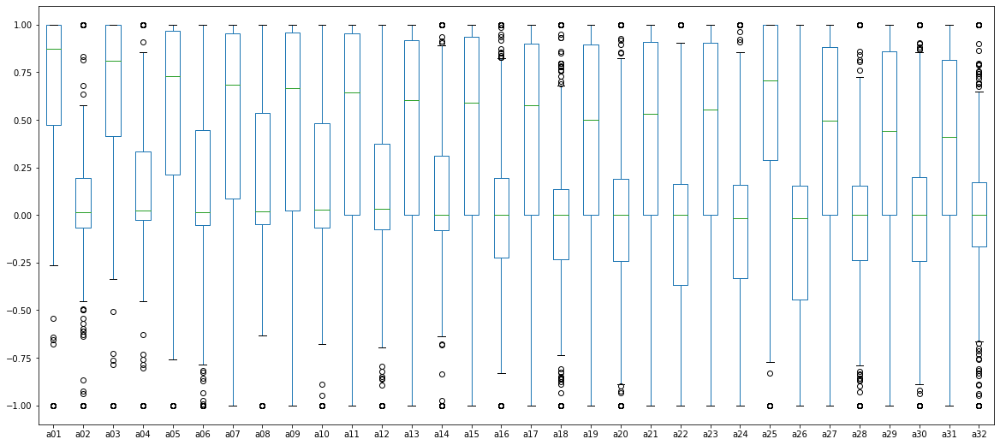

In [ ]:
#rappel
dataquant.boxplot(grid=False,figsize=(20,9))
data_matrix=dataquant.iloc[:,:].values

#on va regarder si les 5 points trouvés sont des anomalies statistiques
for i in range(out.shape[1]-1):
    arr=data_matrix[:,i]
    q1 = np.quantile(arr, 0.25)
    q3 = np.quantile(arr, 0.75)
    med = np.median(arr)
    interq = q3-q1
    #les moustaches
    upper_bound = q3+(1.5*interq)
    lower_bound = q1-(1.5*interq)

    outliers = arr[(arr <= lower_bound) | (arr >= upper_bound)]
    for j in range(5):
        if data_test[ind[j],i] in outliers:
            print('La valeur du point '+str(ind[j])+' pour la variable '+str(i)+' est un outlier')

Bien que certains des 5 points sont des outliers sur plusieurs variables, ce n'est pas le cas pour tous. Certains sont mal projetés sur k composantes bien qu'ils ne soient pas considérés comme des anomalies (par exemple, le point 1 dans les données test).

On va regarder si les 5 points les moins bien projetés sur k composantes sont aussi les moins bien projetés sur p composantes

In [ ]:
#même démarche que précédemment
#on reprend les mêmes individus test de la partie 2. a)
#calcul de la qualité de la projection sur k=10 composantes
M=newcoord(X_test)
Q=Qualite_matrix(M)[:,:-1] #on garde toutes les composantes cette fois sauf la classe

#récupération des 5 individus les moins bien projetés : même code que plus haut
mp=[] #les 5 minima
q=Q[:,-1].tolist()
for i in range(5):
    mp+=[min(q)]
    q.remove(min(q))
print(mp)

indp=[] #indices des 5 points dans data_test/Q
for j in mp:
    indp+=[Q[:,-1].tolist().index(j)]
print(indp)

[0.8172390377937397, 0.8308426871915657, 0.8408359642295702, 0.8445141170023907, 0.8468515809920386]
[20, 53, 75, 101, 96]


In [ ]:
#on compare
print(ind,'\n',indp)

[28, 20, 1, 3, 97] 
 [20, 53, 75, 101, 96]


Parmi les 5 points les moins bien projetés sur k=10 composantes, seul l'individu 20 qui fait également partie des points les moins bien projetés sur p composantes

Les points classés comme anomalies par la forêt d'isolement étaient les points 65, 61, 11, 10, 47. On n'a pas les mêmes résultats : on ne  retrouve aucun point que ce soit dans la projection sur k composantes, ou sur p. On va regarder la qualité de la projection des 5 points trouvés par forêt d'isolement pour comparer :

In [ ]:
indiso=[65,61,11,10,47] #points trouvés par forêt d'isolement
print('Projection sur k=10 composantes (ACP): points ',ind,'\n','projection: ',m)
print('\n')
print('Projection sur k=10 composantes (forêt): points ',indiso,'\n', 'projection :',Q[indiso,9])
print('\n')
print('Projection sur p composantes (ACP): points ',indp,'\n','projection: ',mp)
print('\n')
print('Projection sur p composantes (forêt): points ',indiso,'\n', 'projection :',Q[indiso,-2])

Projection sur k=10 composantes (ACP): points  [28, 20, 1, 3, 97] 
 projection:  [0.12022786348562921, 0.13944344182565765, 0.15202605053672483, 0.1570706445724313, 0.17924615352981857]


Projection sur k=10 composantes (forêt): points  [65, 61, 11, 10, 47] 
 projection : [0.21688525 0.27813602 0.23683075 0.2566696  0.26466469]


Projection sur p composantes (ACP): points  [20, 53, 75, 101, 96] 
 projection:  [0.8172390377937397, 0.8308426871915657, 0.8408359642295702, 0.8445141170023907, 0.8468515809920386]


Projection sur p composantes (forêt): points  [65, 61, 11, 10, 47] 
 projection : [0.90003248 0.97316372 0.96430057 0.97538681 0.88289592]


On voit finalement que les méthodes donnent des résultats différents car les anomalies trouvées par forêt d'isolement ne sont pas nécessairement les points les moins bien projetés par ACP.

## 5.AFD 

l'AFD est  une ACP qui au lieu de résumer un nuage de points, cherche à séparer plusieurs sous-groupes préexistants, mutuellement exclusifs. Ainsi, l'ACP puisse être appliquée aux données étiquetées ainsi qu'aux données non étiquetées car elle ne repose pas sur les étiquettes de sortie. Cependant, LDA nécessite des classes de sortie pour trouver des discriminants linéaires et nécessite donc des données étiquetées

On commence par calculer la matrice de covariance  Σ , la matrice de variance total V, la matrice de covariance interclasse B et la matrice de covariance intraclasse W

In [ ]:
def V_B_W(X,y):
    #calcul W variance intraclasse
    #calcul B variance interclasse
    #calcul V variance total
    p = X.shape[1]
    n = X.shape[0]
    groupe=np.unique(y)
    mean_global=np.mean(X,axis=0)
    W=np.zeros((p,p))
    B=np.zeros((p,p))
    V=np.zeros((p,p))
    for elt in groupe:
        X_e=X[y==elt]
        n_e=X_e.shape[0]
        mean_groupe=np.mean(X_e,axis=0)
        W+=(1/n)*((X_e-mean_groupe).T.dot((X_e-mean_groupe)))
        différence_moyenne=(mean_groupe-mean_global).values.reshape(p,1)
        B+=n_e*((différence_moyenne).dot((différence_moyenne).T))
    V=(1/n)*((X-mean_global).T.dot((X-mean_global)))
    B=(1/n)*B
    return V,B,W

In [ ]:
V,B,W=V_B_W(X_train,y_train)
#pd.DataFrame(V)
#pd.DataFrame(B)
#pd.DataFrame(W)

On remarque bien que V= B+W

On calcule les valeurs propres et les vecteurs propres de la matrice $\Sigma^{-1}B$

In [ ]:
data_transpose1= np.transpose(pd.DataFrame.to_numpy(X_train))
covaraince_data1 = np.cov(data_transpose1, bias=True) 

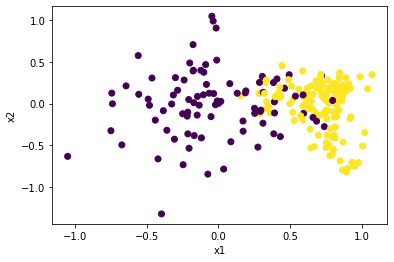

In [ ]:
Sigma_inv = np.linalg.inv(covaraince_data1)
A=Sigma_inv.dot(B)
valp,vectp=np.linalg.eig(A)
vectp=vectp.T
idx=np.argsort(abs(valp))[::-1]#ordre décroissant 
valp=valp[idx]
vectp=vectp[idx]
def Projection(vecteur_propre):
    discrim=vecteur_propre[0:2].T
    discrim=discrim.real
    X_projeté=X_train.dot(discrim)
    x1=X_projeté[0]
    x2=X_projeté[1]
    plt.scatter(x1,x2,c=y_train)
    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.show()
    
Projection(vectp)

Text(0.5, 1.0, 'la variance cumulée')

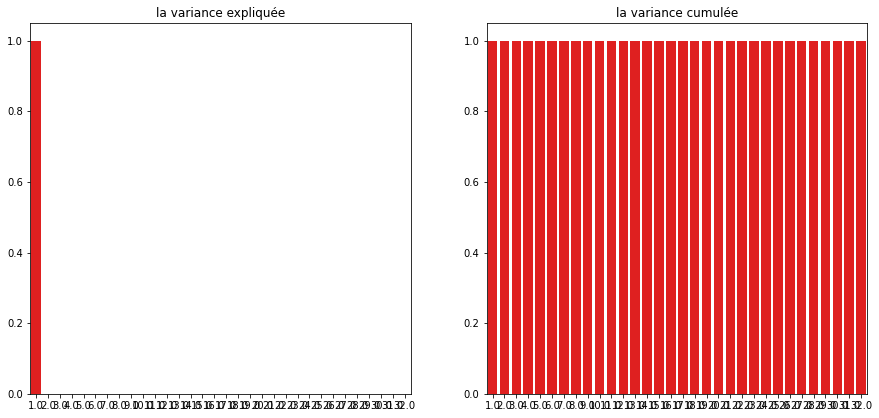

In [ ]:
fig = plt.figure(figsize= (15, 15))
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
sns.barplot(np.linspace(start=1, stop=32, num=32),
            valp.real/(sum(valp.real)),
            color = 'red', 
            ax=ax1).set_title('la variance expliquée')
sns.barplot(np.linspace(start=1, stop=32, num=32),
            np.cumsum(valp.real/(sum(valp.real))),
            color = 'red', 
            ax=ax2).set_title('la variance cumulée')

le nombre de discriminants linéaires est au plus c - 1 où c est le nombre d'étiquettes de classe.  Dans notre cas,on a un seul axe discriminant qu'est associé à la valeur propre différente de 1. Pour cette raison on trace notre nuage selon ce seul axe

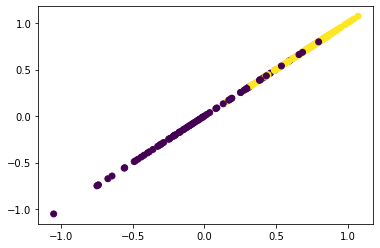

In [ ]:
discrim=vectp[0:1].T
discrim=discrim.real
X_projeté=X_train.dot(discrim)
plt.scatter(X_projeté[0],X_projeté[0],c=y_train)

Diagonalisation de la matrice $V^{-1}B$

On a pensé à diagonaliser la matrice  $𝑉^{−1}𝐵$  par ce qu'on a une sorte d'équivalence entre la diagonalisation de cette dernière et la diagonalisation de la matrice  $\Sigma^{−1}𝐵$  et même aussi la matrice  $𝑤^{−1}𝐵$  selon une dimonstratio fait en cours

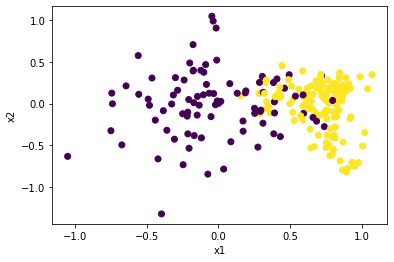

In [ ]:
def nouveau_espace(V,B)  :  
    V_inv = np.linalg.inv(V)
    A=V_inv.dot(B)
    valeur_propre,vecteur_propre=np.linalg.eig(A)
    vecteur_propre=vecteur_propre.T
    idx=np.argsort(abs(valeur_propre))[::-1]#ordre décroissant 
    valeur_propre=valeur_propre[idx]
    vecteur_propre=vecteur_propre[idx]
    return valeur_propre, vecteur_propre

valeur_propre, vecteur_propre=nouveau_espace(V,B)

#transformer 
def Projection(vecteur_propre):
    discrim=vecteur_propre[0:2].T
    discrim=discrim.real
    X_projeté=X_train.dot(discrim)
    x1=X_projeté[0]
    x2=X_projeté[1]
    plt.scatter(x1,x2,c=y_train)
    plt.xlabel('x1')
    plt.ylabel('x2')
    plt.show()
Projection(vecteur_propre)

Text(0.5, 1.0, 'la variance cumulée ')

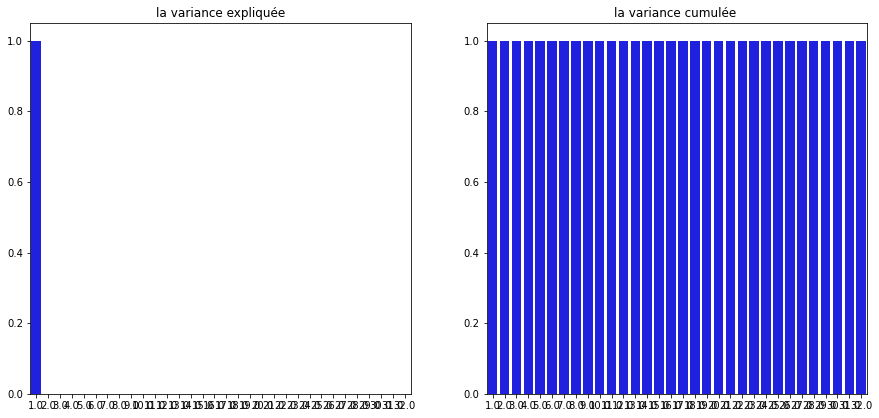

In [ ]:
fig = plt.figure(figsize= (15, 15))
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
sns.barplot(np.linspace(start=1, stop=32, num=32),
            valeur_propre.real/(sum(valeur_propre.real)),
            color = 'blue', 
            ax=ax1).set_title('la variance expliquée')
sns.barplot(np.linspace(start=1, stop=32, num=32),
            np.cumsum(valeur_propre.real/(sum(valeur_propre.real))),
            color = 'blue', 
            ax=ax2).set_title('la variance cumulée ')

Que ce soit en diagonalisant la matrice $\Sigma^{-1}B$ ou la matrice $V^{-1}B$, on remarque que lorsqu'on trace notre nuage que les deux classes 'b' et 'g' ne sont pas vraiment bien séparés. Pour cette raison on a essayé de centraliser les données et ensuite de les normaliser mais on n'a pas vu une grande différence. Ceci peut être justifié par le fait que la normalisation des données n'est pas nécessaire dans LDA car elle n'affecte pas la sortie.En effet,La raison pour laquelle il n'y a pas d'effet de la normalisation sur les principaux résultats dans LDA est que LDA décompose le rapport des covariances entre à l'intérieur, et non la covariance elle-même ayant son ampleur (comme le fait PCA).

In [ ]:
#centralisation des données
datac=data_centre(data_train_df, normalize=True)
X_trainc=datac.loc[:, datac.columns != 'class']
X_testc=datac.loc[:, datac.columns != 'class']
y_trainc=datac['class']
y_testc=datac['class']

### Implimentation de AFD

Dans cette partie on implémente l'ADF on utilisant la fonction déjà prédefinie en python,  Pour rapprocher notamment au mieux nos résultats,  nous  avons  choisi  l’algorithme  «solver  = eigen» qui  impliquele  calcul  explicite  de  la matrice de variance covariance

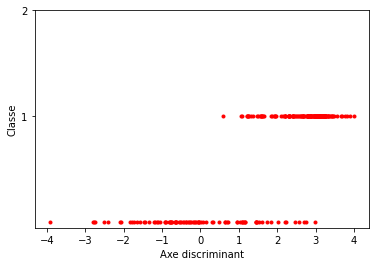

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
method = LinearDiscriminantAnalysis(solver="eigen",store_covariance=True)
lda = method.fit(X_train,y_train)
rndt = lda.transform(X_train)
plt.plot(rndt, y_train, 'r.')
plt.xlabel("Axe discriminant")
plt.ylabel("Classe")
plt.yticks([1, 2])
plt.show()

On remarque qu'il n'exsite aucun axe discriminant qui sépare les deux classes

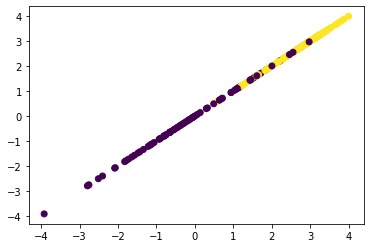

In [ ]:
X_train = method.fit_transform(X_train, y_train)
X_test = method.transform(X_test)
X_lda=method.fit_transform(X_train,y_train)
plt.scatter(X_lda[:,0],X_lda[:,0],c=y_train)

L'implementation d'AFD que se soit par nos propres fonctions, la fonction déjà prédifinie en python ou la fonction prédifinie en R (voir le pdf ci joint à ce document) aboutit au même résultat qui stipule que l'AFD n'est pas discriminante sur ces données. Du coup, on a pensé à enlever les anomalies déjà détecter par l'isolation forest et tracer notre nuage.

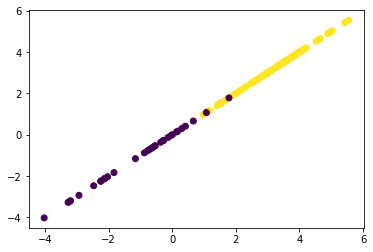

In [ ]:
model=LinearDiscriminantAnalysis(solver="eigen",store_covariance=True)
data_islF.drop('anomaly',1, inplace=True)
X_islF=data_islF.loc[:, data_islF.columns != 'class']
y_islF=data_islF['class']
lda = model.fit(X_islF,y_islF)
X_lda=model.fit_transform(X_islF,y_islF)
plt.scatter(X_lda[:,0],X_lda[:,0],c=y_islF)

On remarque bien que l'AFD est discriminante et que les deux classes sont bien séparés sauf deux points qui ont été mal projétés. Chose qu'est normale puisque la forêt d'isolement rest un modèle non suppervisé qui n'est pas 100% crédible.

### On calcule la qualité de projection des individus test afin de déterminer les 5 individus les mal projetés 

Text(0, 0.5, 'la Qualité')

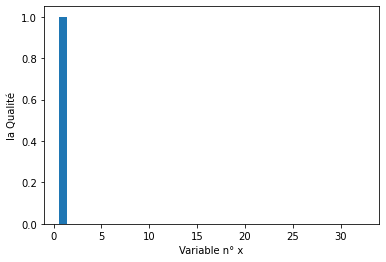

In [ ]:
def qualité_projc(V ,B ):
    V_inv = np.linalg.inv(V)
    Av=V_inv.dot(B)
    valV,vecV=np.linalg.eig(Av)
    valV=valV.real
    qual_proj=[]
    for i in range(len(valV)):
        qual_proj.append(valV[i]/sum(valV))
    return qual_proj
Vtest,Btest,Wtest=V_B_W(X_test,y_test)
A=qualité_projc(Vtest ,Btest)
plt.bar(np.linspace(1,32,32),A)
plt.xlabel('Variable n° x')
plt.ylabel('la Qualité')

In [ ]:
valeur_propre, vecteur_propre=nouveau_espace(Vtest,Btest)
discrim1=vecteur_propre[0:2].T
discrim1=discrim1.real
M=np.dot(X_test,discrim1)
Q=Qualite_matrix(M)[:,:1]
#récupération des 5 individus les moins bien projetés
m=[] #les 5 minima
q=Q[:,-1].tolist()
for i in range(5):
    m+=[min(q)]
    q.remove(min(q))
print(m)

ind=[] #indices des 5 points dans data_test/Q
for j in m:
    ind+=[Q[:,-1].tolist().index(j)]
print(ind)

[3.772480804645661e-05, 0.006080485139482201, 0.011115932903784388, 0.019030092895260742, 0.020926777380083875]
[71, 4, 23, 72, 60]


In [ ]:
#caractéristiques statistiques : comparer à la moyenne et variance
out=np.array([data_test[71,:],
             data_test[4,:],
             data_test[72,:],
             data_test[23,:],
             data_test[60,:]]) #les 5 points trouvés
pd.DataFrame(out)

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
0,0.68729,1.0000,0.91973,-0.76087,0.81773,0.04348,0.76087,0.10702,0.86789,0.73746,...,-0.53846,0.89262,0.22216,0.71070,0.53846,1.000,-0.06522,0.56522,0.23913,0.0
1,1.00000,-0.5421,1.00000,-1.00000,1.00000,-1.00000,1.00000,0.36217,1.00000,-0.41119,...,-0.40888,1.00000,-0.62745,1.00000,-1.00000,1.000,-1.00000,1.00000,-1.00000,0.0
2,0.00000,0.0000,1.00000,0.12889,0.88444,-0.02000,0.00000,0.00000,1.00000,-0.42444,...,0.00000,1.00000,-1.00000,0.00000,0.00000,1.000,0.11778,0.90667,-0.09556,0.0
3,-1.00000,-1.0000,0.00000,0.00000,0.50814,-0.78502,0.60586,0.32899,-1.00000,-0.41368,...,-0.59609,-1.00000,-1.00000,-1.00000,-1.00000,1.000,-1.00000,0.00000,0.00000,0.0
4,0.00000,0.0000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,1.00000,-0.33333,...,0.50000,0.04167,0.75000,-0.22917,-1.00000,-0.125,-0.27083,-0.19792,-0.93750,0.0


In [ ]:
#on va regarder si les 5 points trouvés sont des anomalies statistiques
for i in range(out.shape[1]-1):
    arr=data_matrix[:,i]
    q1 = np.quantile(arr, 0.25)
    q3 = np.quantile(arr, 0.75)
    med = np.median(arr)
    interq = q3-q1
    #les moustaches
    upper_bound = q3+(1.5*interq)
    lower_bound = q1-(1.5*interq)

    outliers = arr[(arr <= lower_bound) | (arr >= upper_bound)]
    for j in range(5):
        if data_test[ind[j],i] in outliers:
            print('La valeur du point '+str(ind[j])+' pour la variable '+str(i)+' est un outlier')

La valeur du point 23 pour la variable 0 est un outlier
La valeur du point 71 pour la variable 1 est un outlier
La valeur du point 4 pour la variable 1 est un outlier
La valeur du point 23 pour la variable 1 est un outlier
La valeur du point 71 pour la variable 3 est un outlier
La valeur du point 4 pour la variable 3 est un outlier
La valeur du point 4 pour la variable 5 est un outlier
La valeur du point 4 pour la variable 13 est un outlier
La valeur du point 4 pour la variable 17 est un outlier
La valeur du point 4 pour la variable 19 est un outlier
La valeur du point 23 pour la variable 19 est un outlier
La valeur du point 4 pour la variable 21 est un outlier
La valeur du point 23 pour la variable 24 est un outlier
La valeur du point 4 pour la variable 27 est un outlier
La valeur du point 23 pour la variable 27 est un outlier
La valeur du point 60 pour la variable 27 est un outlier
La valeur du point 4 pour la variable 29 est un outlier
La valeur du point 23 pour la variable 29 est u

Bien que certains des 5 points sont des outliers sur plusieurs variables, ce n'est pas le cas pour tous. Certains sont mal projetés par l'AFD
bien qu'ils ne soient pas considérés comme des anomalies comme par exemple, l'individu 72 dans les données test. Pourtant, aucun point ne correspont aux points mal projetés par l'ACP que ce soit sur p ou k composantes. De même que la forêt d'isolement. En conclut du coup  que les 3 méthodes AFD et forêt d'isolement et ACP  donnent des résultas  totalement différents

## 6.AFD prédictive 

In [ ]:
label_dic={1:"b",2:"g"}
labels = label_dic.values()
method = LinearDiscriminantAnalysis(solver="eigen",store_covariance=True)
method.fit(X_train, y_train)
scoreLDA = method.score(X_test, y_test)
ypredLDA = method.predict(X_test)
from sklearn.metrics import confusion_matrix
pd.DataFrame(confusion_matrix(y_test, ypredLDA), index = labels, columns=labels)

,b,g
b,24,13
g,3,66


En appliquant la fonction descriminante prédictive sur nos données test, on remarque que AFD a mal classé 16 individus: 13 sont classé dans la classe 'g' alors qu'ils appartient à la classe 'd' et 3 appartient à la classe 'g' ont été étiquité par 'b'. Ainsi, on remarque que le modèle à plus de mal avec la classe 'b'. Pourtant que par notre meilleur modèle de forêt aléatoire,on a que 7 individus qui ont été mal projeté. Ce résultat peut être attendue puisque l'AFD n'était pas trs bien discriminante dans la partie précedente, pour cette raison on applique l'AFD sur nos données test après suppression des anomalies.

In [ ]:
from sklearn.ensemble import IsolationForest
Model= IsolationForest(n_estimators=40, max_samples='auto',contamination='auto',random_state=47,bootstrap=False,n_jobs=None)
data_islF1=data_test_df.copy()
Model.fit(data_islF1)
data_islF1['anomaly']=Model.predict(data_test_df)
A1=pd.DataFrame(data_islF1)
reqd_Index = A1[A1['anomaly']==-1]
anno1=pd.DataFrame(A1[A1['anomaly']==-1])
data_islF1.drop(anno1.index, inplace=True)
data_islF1.drop('anomaly',1, inplace=True)
X_islF1=data_islF1.loc[:, data_islF1.columns != 'class']
y_islF1=data_islF1['class']
y_islF1=pd.DataFrame(y_islF1)

In [ ]:
method1= LinearDiscriminantAnalysis(solver="eigen",store_covariance=True)
method1.fit(X_islF, y_islF)
ypredLDA1 = method1.predict(X_islF1)
from sklearn.metrics import confusion_matrix
pd.DataFrame(confusion_matrix(y_islF1, ypredLDA1), index = labels, columns=labels)

,b,g
b,9,6
g,2,58


On remarque que le nombre d'invidu à diminuer de 16 à 8, presque la moitié. Ainsi, ce résultat est proche de celui de forêt aléatoire

###  Implémentation d'une forêt aléatoire et une AFD  sur les données réduites après ACP 

### Forêt Aléatoire 

on met en œuvre le meilleur modèle trouvé du foret aléatoire sur les données réduites après ACP (k=10)

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA 
pca = PCA(n_components=10)
pca.fit(X_train)
X_train_pca = pca.transform(X_train)
X_test_pca = pca.transform(X_test)
clf = RandomForestClassifier()
clf.fit(X_train_pca, y_train)

RandomForestClassifier()

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix
ypredF = clf.predict(X_test_pca)
pd.DataFrame(confusion_matrix(y_test, ypredF), index = labels, columns=labels)

,b,g
b,33,4
g,5,64


Après ACP, on remarque que le nombre des individus mal classés par Forêt aléaitoire à augmenter par 2 mais comparant au cas initial de la partie 2 ou on a trouvé 7 individus mal projeté, on peut négliger cette augmentation. Du coup, on peut dire que on a le même résultat dans les deux cas.

### AFD 

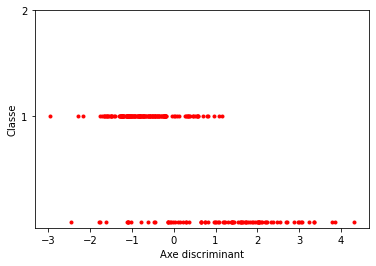

In [ ]:
from sklearn.decomposition import PCA 
pca = PCA(n_components=10)
pca.fit(X_train)
X_train_pca = pca.transform(X_train)
lda = LinearDiscriminantAnalysis(solver="eigen",store_covariance=True)
lda.fit(X_train_pca,y_train)
rndpt = lda.transform(X_train_pca)
plt.plot(rndpt, y_train, 'r.')
plt.xlabel("Axe discriminant")
plt.ylabel("Classe")
plt.yticks([1, 2])
plt.show()

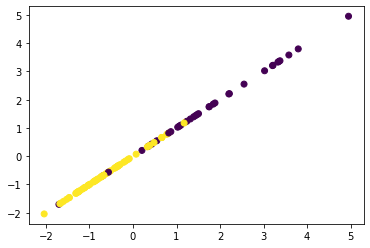

In [ ]:
XL_lda=lda.fit_transform(X_test_pca,y_test)
plt.scatter(XL_lda[:,0],XL_lda[:,0],c=y_test)

On remarque que même avec ACP, l'analyse factorielle discriminante n'est pas bien discriminante et les classes ne sont pas bien séparés

In [ ]:
score = lda.score(X_test_pca, y_test)
ypred = lda.predict(X_test_pca)
pd.DataFrame(confusion_matrix(y_test, ypred), index = labels, columns=labels)

,b,g
b,28,9
g,4,65


On a 13 individus mal classés. Le nombre a diminué par rapport à AFD initial mais il reste quan même très élevés comprant au Forêt aléatoire et au AFD après suppression des anomalie.

#### Conclusion
les anomalies perturbent le fonctionnement de la fonction discriminante, à savoir que les meilleur résulat qu'on a trouvé c'était après la suppression de ces anomalies ou points aberrantes. La forêt aléatoire, elle aussi nous a fourni une bonne classification des individus selon les deux classes 'g' et 'b'.